In [341]:
from __future__ import print_function
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.autograd import Variable
import PIL

# Взводим руками рандом сид для воспроизводимости обучения
manualSeed = 333
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  333


In [342]:
# Директория с датасетом покемонов. Внимание!!! Чтобы даталоадер работал, необходимо положить картинки в 
# папку по типу .../pokemon/1/0.png, .../pokemon/1/1.png и т.д. Без этого даталоадер работать не будет
dataroot = "./pokemon/"

# Количество воркеров для даталоадера
workers = 1

# Размер батча для обучения
batch_size = 64

# Размер скрытого вектора z
nz = 100

# Кол-во эпох обучения
num_epochs = 1500

In [343]:
# Размер картинки (применяется в transform)
image_size = 64

# номер видеокарты
device_num = 2

# константы для generator & discriminator
leaky_relu_coef = 0.2
feature_map_size = 64

In [344]:
torch.cuda.set_device(device_num)

Current device : cuda:2


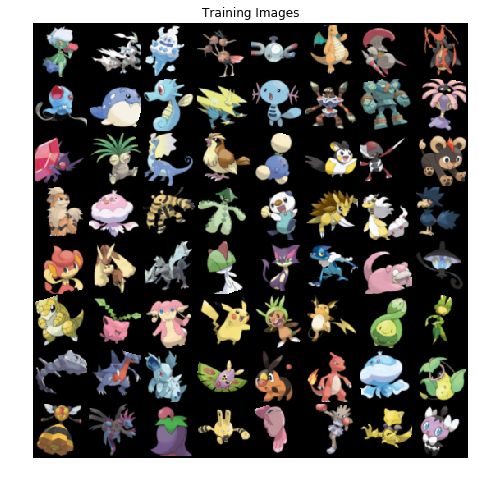

In [345]:
# Создаем даталоадер
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),   
                               transforms.Pad(5),
                               transforms.RandomCrop(image_size),
                               transforms.RandomHorizontalFlip(),
                               transforms.RandomRotation(20, resample=PIL.Image.BILINEAR),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# переключаемся на куду
device = torch.device("cuda:{}".format(device_num) if torch.cuda.is_available() else "cpu")

print("Current device : {}".format(device))

# Выведем трейнсет, дабы убедиться, что все завелось
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [346]:
# функция для инициализации весов из статьи про GAN
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [347]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, feature_map_size * 8, kernel_size=4, bias=False),
            nn.BatchNorm2d(feature_map_size * 8),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.ConvTranspose2d(feature_map_size * 8, feature_map_size * 4, 
                               kernel_size=4, 
                               stride=2, 
                               padding=1, 
                               bias=False),
            nn.BatchNorm2d(feature_map_size * 4),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.ConvTranspose2d(feature_map_size * 4, feature_map_size * 2, 
                               kernel_size=4, 
                               stride=2, 
                               padding=1, 
                               bias=False),
            nn.BatchNorm2d(feature_map_size * 2),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.ConvTranspose2d(feature_map_size * 2, feature_map_size, 
                               kernel_size=4, 
                               stride=2, 
                               padding=1, 
                               bias=False),
            nn.BatchNorm2d(feature_map_size),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            nn.ConvTranspose2d(feature_map_size, 3, 
                               kernel_size=4, 
                               stride=2, 
                               padding=1, 
                               bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [348]:
# Создали генератор
netG = Generator().to(device)

# Инициализировали его
netG.apply(weights_init)

# Вывели модель для отладки
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace)
    (12): ConvTranspose2d(64, 3, kernel

In [349]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, feature_map_size, 
                      kernel_size=4, 
                      stride=2, 
                      padding=1, 
                      bias=False),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.Conv2d(feature_map_size, feature_map_size * 2, 
                      kernel_size=4, 
                      stride=2, 
                      padding=1, 
                      bias=False),
            nn.BatchNorm2d(feature_map_size * 2),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.Conv2d(feature_map_size * 2, feature_map_size * 4, 
                      kernel_size=4, 
                      stride=2, 
                      padding=1, 
                      bias=False),
            nn.BatchNorm2d(feature_map_size * 4),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.Conv2d(feature_map_size * 4, feature_map_size * 8, 
                      kernel_size=4, 
                      stride=2, 
                      padding=1, 
                      bias=False),
            nn.BatchNorm2d(feature_map_size * 8),
            nn.LeakyReLU(leaky_relu_coef, inplace=True),
            
            nn.Conv2d(feature_map_size * 8, 1, kernel_size=4, bias=False)
        )

    def forward(self, input):
        return self.main(input)

In [350]:
# Создали дискриминатор
netD = Discriminator().to(device)

# Ининциализировали весе
netD.apply(weights_init)

# Вывели модель для отладки
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


In [351]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

In [352]:
# Коэффициент обучения
lr = 0.00005

# Оптимизаторы для сеток
optimizerD = optim.RMSprop(netD.parameters(), lr=lr)
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

In [353]:
# код для обучения дискриминатора
d_episodes = 5

def train_D(data):
    d_losses = []
    real_scores = []
    fake_scores = []
    for _ in range(d_episodes):
        netD.zero_grad()
        
        real_data = data.to(device)
        b_size = real_data.size(0)
        
        real_score = netD(real_data).view(-1)

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        fake_score = netD(fake.detach()).view(-1)

        d_loss = -(torch.mean(real_score) - torch.mean(fake_score))
        d_loss.backward()
        optimizerD.step()
        
        for p in netD.parameters():
            p.data.clamp_(-0.01, 0.01)
            
        d_losses.append(d_loss)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

    return torch.Tensor(d_losses).mean(), torch.cat(real_scores).mean(), torch.cat(fake_scores).mean()   

In [354]:
# код для обучения генератора
def train_G(data):
    netG.zero_grad()
    
    real_data = data.to(device)
    b_size = real_data.size(0)
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    
    fake = netG(noise)

    fake_score = netD(fake).view(-1)
    g_loss = -torch.mean(fake_score)

    g_loss.backward()
    optimizerG.step()
    return g_loss

In [355]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):     
     for i, (data,_) in enumerate(dataloader, 0):
        # обучаем дискриминатор
        # d_loss = wasserstein loss дискриминатора
        # real_score - оценки дискриминатора для настоящих картинок
        # fake_score - оценки дискриминатора для фейковых картинок
        # помните, что на одну итерацию обучения генератора
        # должно приходиться несколько итераций обучения дискриминатора!
        d_loss, real_score, fake_score = train_D(data)
        
        # обучаем генератор
        # g_loss = critic-loss генератора
        g_loss = train_G(data)
        
        # Выводим стату
        if i % 1 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     d_loss.item(), g_loss.item(), real_score.mean().item(), fake_score.mean().item()))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Сохраняем результат генерации для нашего фиксированного шума( для валидации )
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/1500][0/13]	Loss_D: -0.0326	Loss_G: 0.0099	D(x): 0.1592	D(G(z)): 0.1266
[0/1500][1/13]	Loss_D: -0.0260	Loss_G: -0.0048	D(x): 0.0346	D(G(z)): 0.0085
[0/1500][2/13]	Loss_D: -0.0298	Loss_G: -0.0122	D(x): 0.0465	D(G(z)): 0.0167
[0/1500][3/13]	Loss_D: -0.0285	Loss_G: -0.0144	D(x): 0.0496	D(G(z)): 0.0211
[0/1500][4/13]	Loss_D: -0.0356	Loss_G: -0.0133	D(x): 0.0574	D(G(z)): 0.0218
[0/1500][5/13]	Loss_D: -0.0383	Loss_G: -0.0091	D(x): 0.0571	D(G(z)): 0.0188
[0/1500][6/13]	Loss_D: -0.0507	Loss_G: -0.0069	D(x): 0.0663	D(G(z)): 0.0156
[0/1500][7/13]	Loss_D: -0.0547	Loss_G: -0.0044	D(x): 0.0690	D(G(z)): 0.0142
[0/1500][8/13]	Loss_D: -0.0675	Loss_G: -0.0005	D(x): 0.0798	D(G(z)): 0.0123
[0/1500][9/13]	Loss_D: -0.0726	Loss_G: 0.0072	D(x): 0.0797	D(G(z)): 0.0071
[0/1500][10/13]	Loss_D: -0.0769	Loss_G: 0.0132	D(x): 0.0792	D(G(z)): 0.0023
[0/1500][11/13]	Loss_D: -0.0866	Loss_G: 0.0198	D(x): 0.0842	D(G(z)): -0.0023
[0/1500][12/13]	Loss_D: -0.1025	Loss_G: 0.0335	D(x): 0.0944	D(G

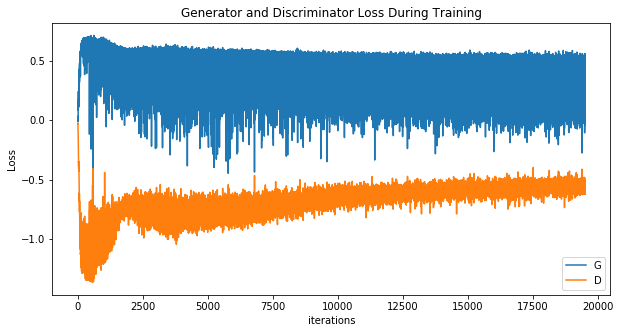

In [356]:
# Выводим на печать всяческие loss'ы
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21265793 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


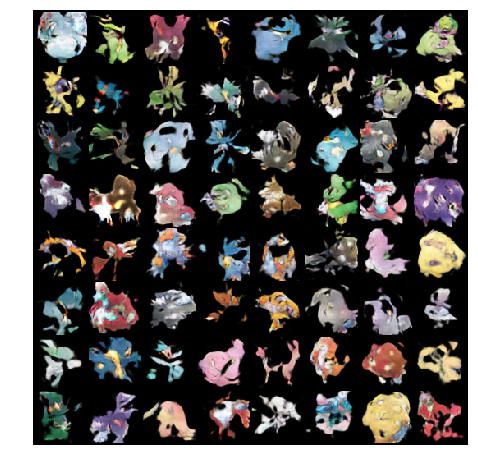

In [357]:
# Проигрываем результаты генерации для фиксированного шума
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

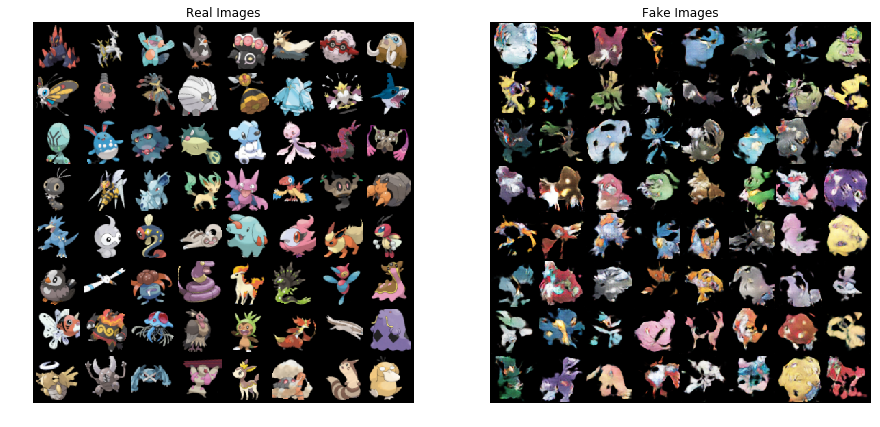

In [358]:
# Сравниваем настоящие данные и генерацию
real_batch = next(iter(dataloader))

# Рисуем трейнсет
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Рисуем фейки
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()